# Water mass classification with multiple unsupervised machine learning methods

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [2]:
# Access data from csv that Kate shared
df = pd.read_csv('WMA_fractions_v2.csv', skiprows=1)

In [3]:
print(df.head())

   Arctic_Surface_Water_[fraction]  Modified_summer_Pacific_Water_[fraction]  \
0                         0.000000                                  0.000000   
1                         0.000154                                  0.000148   
2                         0.000322                                  0.000295   
3                         0.000274                                  0.000256   
4                         0.000124                                  0.000116   

   Summer_Pacific_Water_[fraction]  Winter_Pacific_Water_[fraction]  \
0                         0.002680                         0.000000   
1                         0.000496                         0.000102   
2                         0.000327                         0.000134   
3                         0.000259                         0.000111   
4                         0.000117                         0.000051   

   Norwegian_Current_Water_[fraction]  Atlantic_Water_[fraction]  \
0                       

In [4]:
print(df.columns)

Index(['Arctic_Surface_Water_[fraction]',
       'Modified_summer_Pacific_Water_[fraction]',
       'Summer_Pacific_Water_[fraction]', 'Winter_Pacific_Water_[fraction]',
       'Norwegian_Current_Water_[fraction]', 'Atlantic_Water_[fraction]',
       'Brine-enriched_Water_[fraction]', 'Conservative_Temperature_[deg_C]',
       'Absolute_Salinity_[PSU]', 'Latitude_[deg_N]', 'Depth_[m]',
       'Longitude_[deg_E]', 'Dissolved_Oxygen_[micro_mol_per_kg]',
       'Datetime_[UTC]', 'Source', 'Profile_Number'],
      dtype='object')


In [4]:
# Save data frame with only the temperature, salinity and oxygen columns
df_STO = df[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]

In [5]:
df_STO.head()

,Conservative_Temperature_[deg_C],Absolute_Salinity_[PSU],Dissolved_Oxygen_[micro_mol_per_kg]
0,9.222,35.352,NaN
1,7.958,35.402,NaN
2,7.831,35.402,NaN
3,7.724,35.400,NaN
4,7.550,35.395,NaN


In [6]:
# Save data frame with only the temperature and salinity columns
df_ST = df_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]']]

In [15]:
df_ST.head()

,Conservative_Temperature_[deg_C],Absolute_Salinity_[PSU]
0,9.222,35.352
1,7.958,35.402
2,7.831,35.402
3,7.724,35.400
4,7.550,35.395


# Ground truth

In [4]:
threshold = 0.501

# Select only the first 7 columns (water mass fractions)
wm_cols = df.columns[:7]

# Classify based on those columns
df['classification'] = df[wm_cols].apply(lambda r: r.idxmax() if r.max() >= threshold else 'Mixed', axis=1)

In [5]:
print(df['classification'].value_counts())

classification
Atlantic_Water_[fraction]             7058863
Norwegian_Current_Water_[fraction]    1595816
Mixed                                 1267410
Brine-enriched_Water_[fraction]        721424
Arctic_Surface_Water_[fraction]        387861
Winter_Pacific_Water_[fraction]        350927
Summer_Pacific_Water_[fraction]         20623
Name: count, dtype: int64


In [4]:
colors = {
    'Atlantic_Water_[fraction]': 'blue',
    'Norwegian_Current_Water_[fraction]': 'cyan',
    'Brine-enriched_Water_[fraction]': 'purple',
    'Arctic_Surface_Water_[fraction]': 'green',
    'Winter_Pacific_Water_[fraction]': 'orange',
    'Summer_Pacific_Water_[fraction]': 'red',
    'Mixed': 'gray'
}

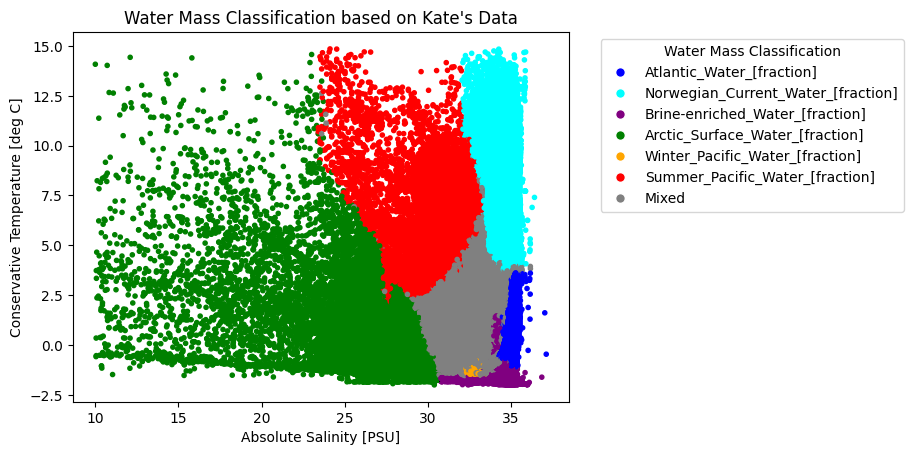

In [8]:
plt.scatter(df['Absolute_Salinity_[PSU]'], df['Conservative_Temperature_[deg_C]'], c=df['classification'].map(colors), marker='.')
plt.xlabel('Absolute Salinity [PSU]')
plt.ylabel('Conservative Temperature [deg C]')
plt.title("Water Mass Classification based on Kate's Data")
plt.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=7, label=label) for label, color in colors.items()], title='Water Mass Classification', bbox_to_anchor=(1.05, 1), loc='upper left')

# By max instead of threshold

In [3]:
wm_cols = df.columns[:7]

df['classification'] = df[wm_cols].idxmax(axis=1)

In [6]:
print(df['classification'].value_counts())

classification
Atlantic_Water_[fraction]                   7279546
Norwegian_Current_Water_[fraction]          1748690
Brine-enriched_Water_[fraction]             1002255
Winter_Pacific_Water_[fraction]              788694
Arctic_Surface_Water_[fraction]              536060
Summer_Pacific_Water_[fraction]               46000
Modified_summer_Pacific_Water_[fraction]       1679
Name: count, dtype: int64


In [4]:
colors = {
    'Atlantic_Water_[fraction]': 'blue',
    'Norwegian_Current_Water_[fraction]': 'cyan',
    'Brine-enriched_Water_[fraction]': 'purple',
    'Arctic_Surface_Water_[fraction]': 'green',
    'Winter_Pacific_Water_[fraction]': 'orange',
    'Summer_Pacific_Water_[fraction]': 'red',
    'Modified_summer_Pacific_Water_[fraction]': 'gray'
}

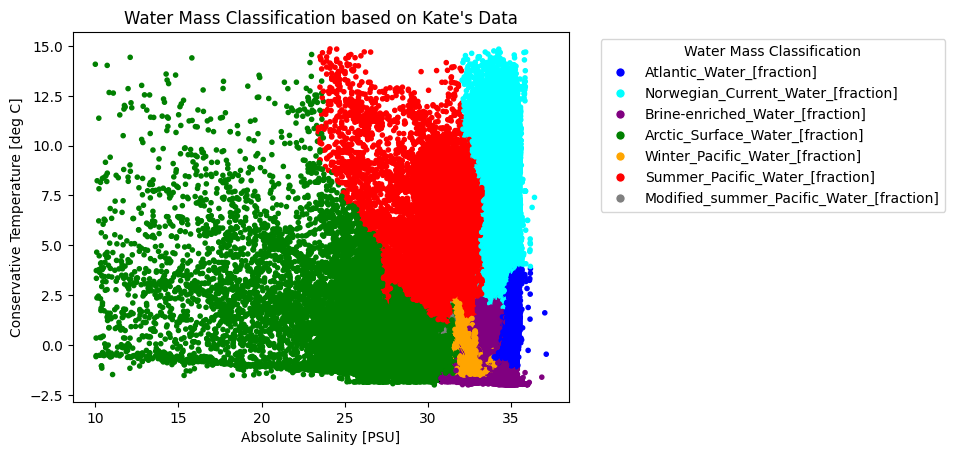

In [20]:
plt.scatter(df['Absolute_Salinity_[PSU]'], df['Conservative_Temperature_[deg_C]'], c=df['classification'].map(colors), marker='.')
plt.xlabel('Absolute Salinity [PSU]')
plt.ylabel('Conservative Temperature [deg C]')
plt.title("Water Mass Classification based on Kate's Data")
plt.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=7, label=label) for label, color in colors.items()], title='Water Mass Classification', bbox_to_anchor=(1.05, 1), loc='upper left')

# Oxygen Salinity Ground Truth

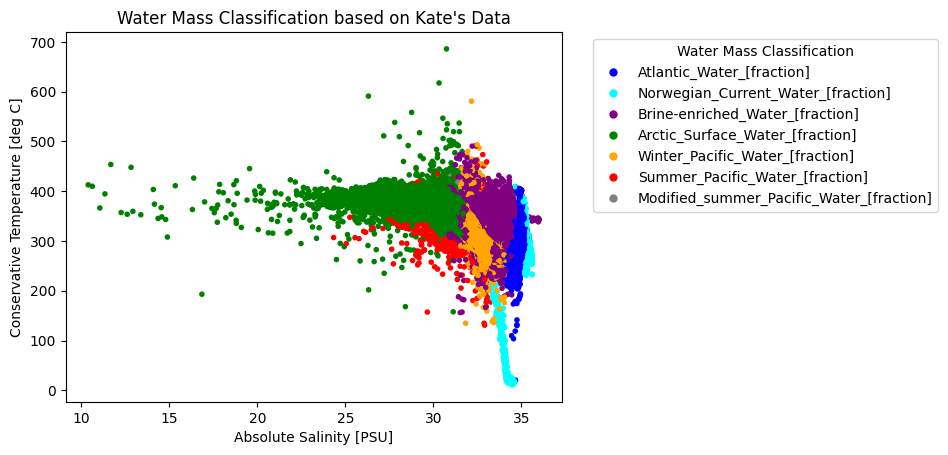

In [5]:
plt.scatter(df['Absolute_Salinity_[PSU]'], df['Dissolved_Oxygen_[micro_mol_per_kg]'], c=df['classification'].map(colors), marker='.')
plt.xlabel('Absolute Salinity [PSU]')
plt.ylabel('Dissolved Oxygen [micro mol per kg]')
plt.title("Water Mass Classification based on Kate's Data")
plt.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=7, label=label) for label, color in colors.items()], title='Water Mass Classification', bbox_to_anchor=(1.05, 1), loc='upper left')

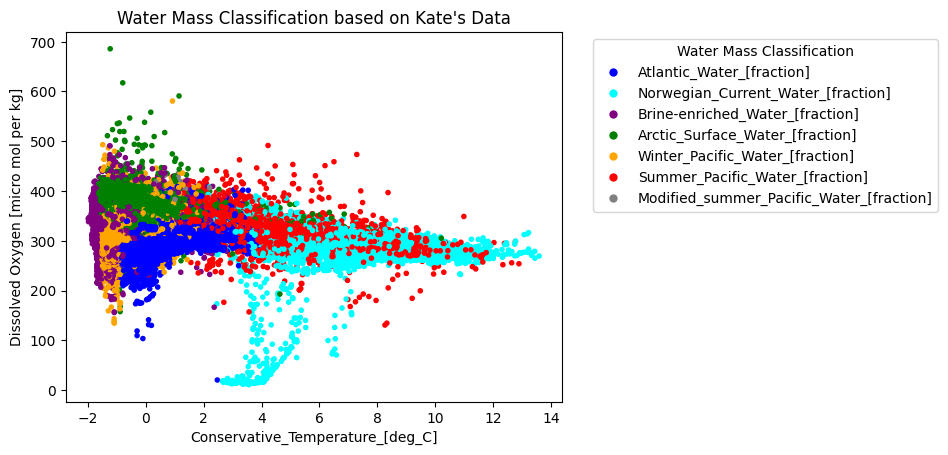

In [6]:
plt.scatter(df['Conservative_Temperature_[deg_C]'], df['Dissolved_Oxygen_[micro_mol_per_kg]'], c=df['classification'].map(colors), marker='.')
plt.xlabel('Conservative_Temperature_[deg_C]')
plt.ylabel('Dissolved Oxygen [micro mol per kg]')
plt.title("Water Mass Classification based on Kate's Data")
plt.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=7, label=label) for label, color in colors.items()], title='Water Mass Classification', bbox_to_anchor=(1.05, 1), loc='upper left')

# Water mass classification (max) in Log Scale

In [8]:
df_log = df.copy()
df_log['log_Temp']= np.log(df['Conservative_Temperature_[deg_C]']/35)
df_log['log_Sal']= np.log(df['Absolute_Salinity_[PSU]']/10)
df_log['classification_log'] = df_log[wm_cols].idxmax(axis=1)


/Users/franciscagomes/PhD/WM_class/.venv/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/franciscagomes/PhD/WM_class/.venv/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [9]:
df_log.head()

,Arctic_Surface_Water_[fraction],Modified_summer_Pacific_Water_[fraction],Summer_Pacific_Water_[fraction],Winter_Pacific_Water_[fraction],Norwegian_Current_Water_[fraction],Atlantic_Water_[fraction],Brine-enriched_Water_[fraction],Conservative_Temperature_[deg_C],Absolute_Salinity_[PSU],Latitude_[deg_N],Depth_[m],Longitude_[deg_E],Dissolved_Oxygen_[micro_mol_per_kg],Datetime_[UTC],Source,Profile_Number,classification,log_Temp,log_Sal,classification_log
0,0.000000,0.000000,0.002680,0.000000,0.997320,0.000000,0.000000,9.222,35.352,63.315,15.0,-0.075,NaN,2009-08-09,argo,1,Norwegian_Current_Water_[fraction],-1.333756,1.262770,Norwegian_Current_Water_[fraction]
1,0.000154,0.000148,0.000496,0.000102,0.995409,0.003583,0.000107,7.958,35.402,63.317,105.0,-0.017,NaN,2009-08-09,argo,1,Norwegian_Current_Water_[fraction],-1.481170,1.264183,Norwegian_Current_Water_[fraction]
2,0.000322,0.000295,0.000327,0.000134,0.979148,0.019728,0.000046,7.831,35.402,63.318,115.0,-0.090,NaN,2009-08-09,argo,1,Norwegian_Current_Water_[fraction],-1.497258,1.264183,Norwegian_Current_Water_[fraction]
3,0.000274,0.000256,0.000259,0.000111,0.965319,0.033748,0.000033,7.724,35.400,63.309,125.0,-0.068,NaN,2009-08-09,argo,1,Norwegian_Current_Water_[fraction],-1.511016,1.264127,Norwegian_Current_Water_[fraction]
4,0.000124,0.000116,0.000117,0.000051,0.944119,0.055455,0.000017,7.550,35.395,63.368,135.0,-0.018,NaN,2009-08-09,argo,1,Norwegian_Current_Water_[fraction],-1.533800,1.263985,Norwegian_Current_Water_[fraction]


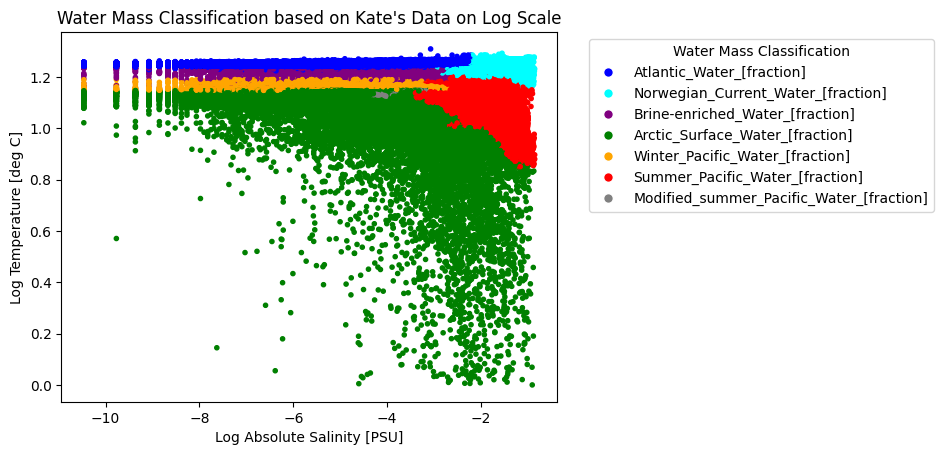

In [12]:
plt.scatter(df_log['log_Temp'], df_log['log_Sal'], c=df_log['classification_log'].map(colors), marker='.')
plt.xlabel('Log Temperature [deg C]')
plt.ylabel('Log Absolute Salinity [PSU]')
plt.title("Water Mass Classification based on Kate's Data on Log Scale")
plt.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=7, label=label) for label, color in colors.items()], title='Water Mass Classification', bbox_to_anchor=(1.05, 1), loc='upper left')

# KMeans

In [9]:
# Try different clustering methods from sklearn
from sklearn.cluster import KMeans

In [47]:
# Elbow method to find optimal number of clusters
n_clusters = range(1, 12)
inertias = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=0)
    kmeans.fit(df_ST)
    df_ST[f'cluster_{n}'] = kmeans.labels_
    inertia = kmeans.inertia_
    inertias.append(inertia) 

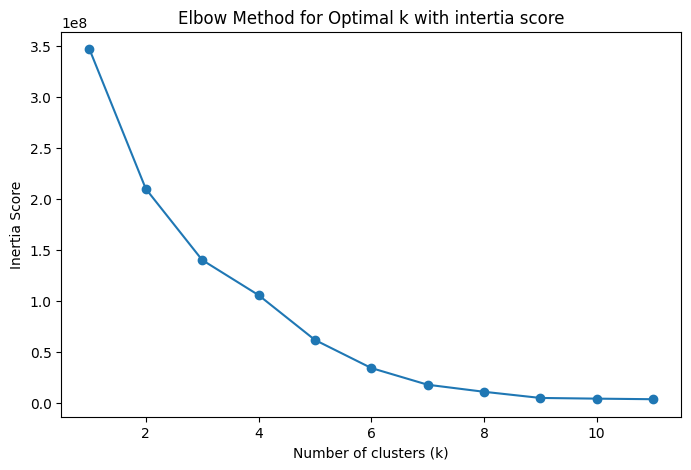

In [50]:
plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [ ]:
# Silhouette score elbow method to find optimal number of clusters

In [6]:
import sklearn.metrics as metrics

In [61]:
n_clusters = range(2, 12)
scores = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=0)
    kmeans.fit(df_ST)
    df_ST[f'cluster_{n}'] = kmeans.labels_
    sil = metrics.silhouette_score(df_ST,df_ST[f'cluster_{n}'])
    scores.append(sil)

KeyboardInterrupt: 

In [ ]:
# Do kmeans to plot with 7 clusters (since we know we have 7 water masses)

In [13]:
kmeans = KMeans(n_clusters=7).fit(df_ST)

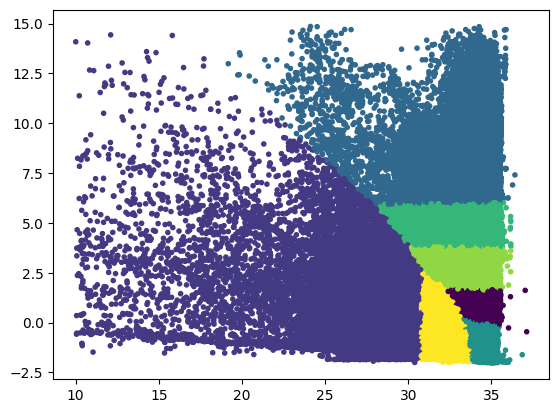

In [15]:
plt.scatter(df_ST['Absolute_Salinity_[PSU]'], df_ST['Conservative_Temperature_[deg_C]'], c=kmeans.labels_, marker='.')
plt.xlabel('Absolute Salinity [PSU]')
plt.ylabel('Conservative Temperature [deg C]')
plt.title('KMeans Clustering with 7 Clusters')

# DBSCAN

In [10]:
df_ST_sampled = df_ST.sample(n=100000, random_state=22)

In [11]:
from sklearn.cluster import DBSCAN

In [15]:
db = DBSCAN(eps=0.2, min_samples=1000).fit(df_ST_sampled)
labels = db.labels_

In [16]:
import matplotlib.pyplot as plt

Text(0.5, 1.0, 'DBSCAN Clustering for Sampled Data')

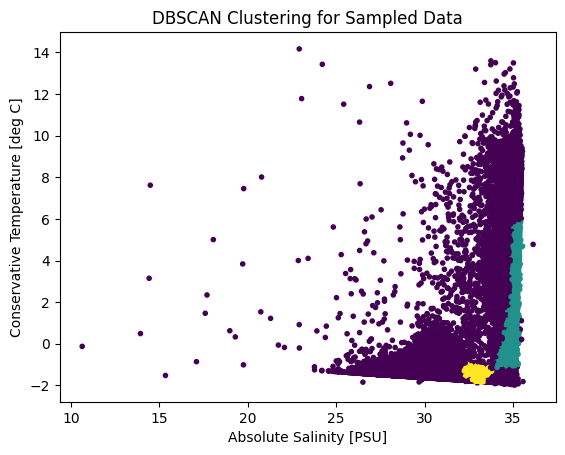

In [17]:
plt.scatter(df_ST_sampled['Absolute_Salinity_[PSU]'], df_ST_sampled['Conservative_Temperature_[deg_C]'], c=labels, marker='.')
plt.xlabel('Absolute Salinity [PSU]')
plt.ylabel('Conservative Temperature [deg C]')
plt.title('DBSCAN Clustering for Sampled Data')

In [ ]:
# spatial sampling 

# Agglomerative clustering

In [13]:
df_ST_sampled = df_ST.sample(n=40000, random_state=22)

In [14]:
from sklearn.cluster import AgglomerativeClustering

In [15]:
ac = AgglomerativeClustering(n_clusters=7).fit(df_ST_sampled)
labels = ac.labels_

Text(0.5, 1.0, 'Agglomerative Clustering with 7 Clusters for Sampled Data')

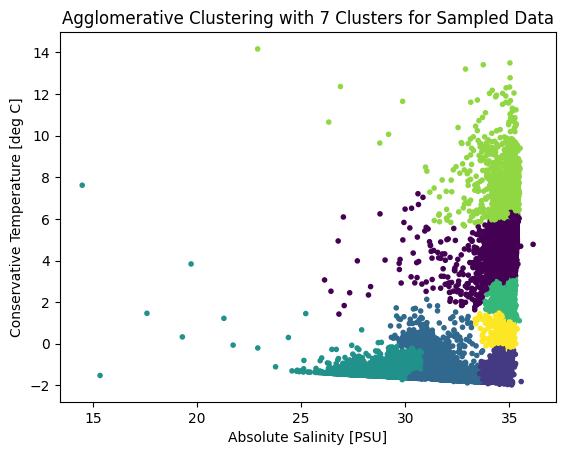

In [16]:
plt.scatter(df_ST_sampled['Absolute_Salinity_[PSU]'], df_ST_sampled['Conservative_Temperature_[deg_C]'], c=labels, marker='.')
plt.xlabel('Absolute Salinity [PSU]')
plt.ylabel('Conservative Temperature [deg C]')
plt.title('Agglomerative Clustering with 7 Clusters for Sampled Data')

# 3D kmeans


In [7]:
from sklearn.cluster import KMeans

In [8]:
# only have the data points that have all three quantities (temperature, salinity, oxygen)
df_STO_3 = df_STO.dropna()

In [9]:
kmeans = KMeans(n_clusters=7).fit(df_STO_3)

Text(0.5, 1.0, 'KMeans Clustering with 7 Clusters on STO Data (Salinity vs Oxygen)')

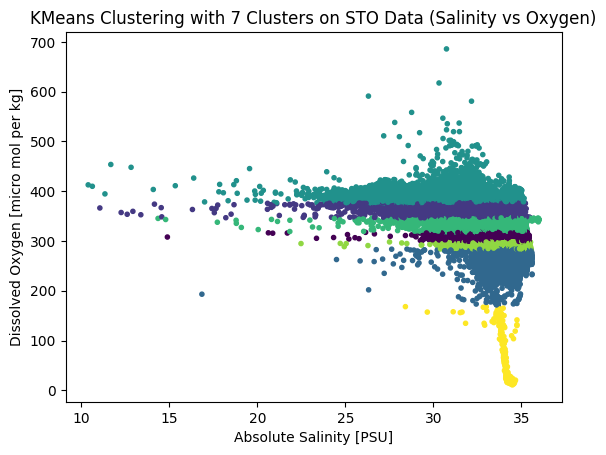

In [17]:
# Plot oxygen vs salinity colored by kmeans labels
plt.scatter(df_STO_3['Absolute_Salinity_[PSU]'], df_STO_3['Dissolved_Oxygen_[micro_mol_per_kg]'], c=kmeans.labels_, marker='.')
plt.xlabel('Absolute Salinity [PSU]')
plt.ylabel('Dissolved Oxygen [micro mol per kg]')
plt.title('KMeans Clustering with 7 Clusters on STO Data (Salinity vs Oxygen)')

Text(0.5, 1.0, 'KMeans Clustering with 7 Clusters on STO Data (Temperature vs Oxygen)')

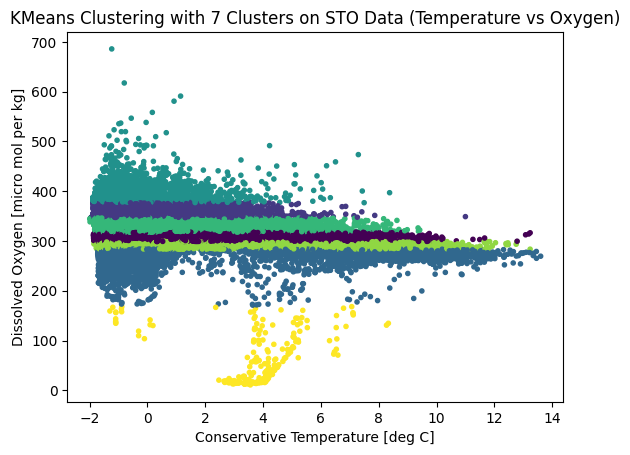

In [18]:
# Plot oxygen vs temperature colored by kmeans labels
plt.scatter(df_STO_3['Conservative_Temperature_[deg_C]'], df_STO_3['Dissolved_Oxygen_[micro_mol_per_kg]'], c=kmeans.labels_, marker='.')
plt.xlabel('Conservative Temperature [deg C]')
plt.ylabel('Dissolved Oxygen [micro mol per kg]')
plt.title('KMeans Clustering with 7 Clusters on STO Data (Temperature vs Oxygen)')

Text(0.5, 0.92, 'KMeans Clustering with 7 Clusters on STO Data (3D)')

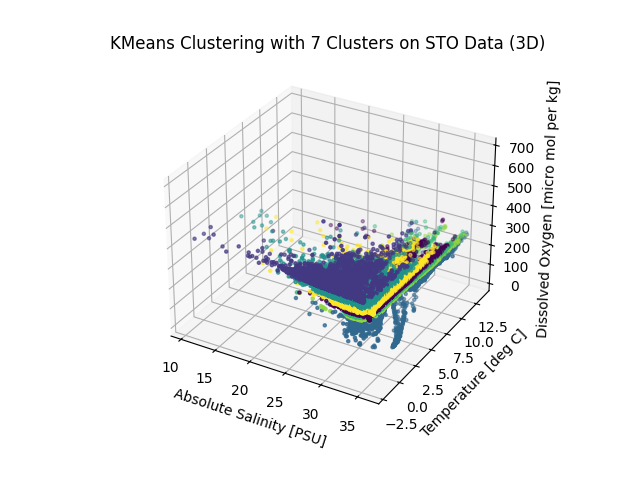

In [11]:
# Plot Temperature, salinity and oxygen in 3D colored by kmeans labels
%matplotlib widget
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(df_STO_3['Absolute_Salinity_[PSU]'], df_STO_3['Conservative_Temperature_[deg_C]'], df_STO_3['Dissolved_Oxygen_[micro_mol_per_kg]'], c=kmeans.labels_, marker='.')
ax.set_xlabel('Absolute Salinity [PSU]')
ax.set_ylabel('Temperature [deg C]')
ax.set_zlabel('Dissolved Oxygen [micro mol per kg]')
plt.title('KMeans Clustering with 7 Clusters on STO Data (3D)')

In [ ]:
# Oxygen salinity ground truth



# Different method for 3D kmeans on STO data

In [38]:
# creating a two dimentional matrix 
X = df_STO_3.iloc[:,[0,1,2]].values

In [31]:
print(X)

[[  7.568  35.2   299.264]
 [  7.529  35.199 298.703]
 [  6.17   35.25  296.322]
 ...
 [ -1.86   34.48  380.37 ]
 [ -1.859  34.48  380.31 ]
 [ -1.834  34.488 379.4  ]]


In [35]:
kmeans = KMeans(n_clusters=7, random_state=22)
y_kmeans = kmeans.fit_predict(X)

In [46]:
import plotly.graph_objs as go

scatter = go.Scatter3d(
    x=X[:,0],
    y=X[:,1],
    z=X[:,2],
    mode='markers',
    marker=dict(
        size=6,
        color=y_kmeans,       # cluster labels
        colorscale='Viridis'
    )
)

fig = go.Figure(data=[scatter])
fig.update_layout(
    scene=dict(
        xaxis_title='Temperature (°C)',
        yaxis_title='Salinity (PSU)',
        zaxis_title='Oxygen (µmol/kg)'
    )
)

import plotly.io as pio
pio.renderers.default = 'browser' # figure opens in browser

fig.show()

# lat lon plotting of water masses

In [52]:
# Plot water mass classification (kmeans) in lat lon plot
import plotly.express as px

# copy data frame to avoid modifying original
df_STO_latlon = df.copy()

# keep only relevant columns (lat, lon, temperature, salinity, oxygen)
df_STO_latlon = df_STO_latlon[['Latitude_[deg_N]', 'Longitude_[deg_E]', 'Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]

# drop rows with missing values (oxygen)
df_STO_latlon = df_STO_latlon.dropna()

# apply kmeans clustering
kmeans = KMeans(n_clusters=7, random_state=22)
X_latlon = df_STO_latlon.iloc[:,[2,3,4]].values
y_kmeans = kmeans.fit_predict(X_latlon)

# add kmeans classification to data frame
df_STO_latlon['kmeans_classification'] = y_kmeans

# plot on geographic map
fig = px.scatter_geo(df_STO_latlon, lat='Latitude_[deg_N]', lon='Longitude_[deg_E]', color='kmeans_classification',
                     title='Water Mass Classification (KMeans) on Geographic Map')
fig.update_geos(projection_type="orthographic")
fig.show()

In [54]:
import plotly.express as px

# Compute data centroid (mean location)
center_lat = df_STO_latlon['Latitude_[deg_N]'].mean()
center_lon = df_STO_latlon['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat, "Center lon:", center_lon)

fig = px.scatter_geo(
    df_STO_latlon,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) – Centered on Data Distribution'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat, lon=center_lon),   # ⭐ Center map on data
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()


Center lat: 80.17586786575906 Center lon: -91.60875191020989


# Use only surface (least depth data)

In [6]:
from sklearn.cluster import KMeans

In [3]:
df_surface = df.copy()
df_surface = df_surface[df_surface['Depth_[m]'] <= 20]

In [4]:
df_surface_STO = df_surface[['Latitude_[deg_N]', 'Longitude_[deg_E]','Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]
df_surface_STO = df_surface_STO.dropna()

In [61]:
# Do kmeans clustering on surface data
kmeans_surface = KMeans(n_clusters=7, random_state=22)
X_surface = df_surface_STO.iloc[:,[0,1,2]].values
y_kmeans_surface = kmeans_surface.fit_predict(X_surface)
df_surface_STO['kmeans_classification'] = y_kmeans_surface

In [63]:
# Plot in geographic map
# Compute data centroid (mean location)
center_lat_surf = df_surface_STO['Latitude_[deg_N]'].mean()
center_lon_surf = df_surface_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat_surf, "Center lon:", center_lon_surf)

fig = px.scatter_geo(
    df_surface_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) – Centered on Data Distribution'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat_surf, lon=center_lon_surf),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 79.19223813684268 Center lon: -86.13598615737453


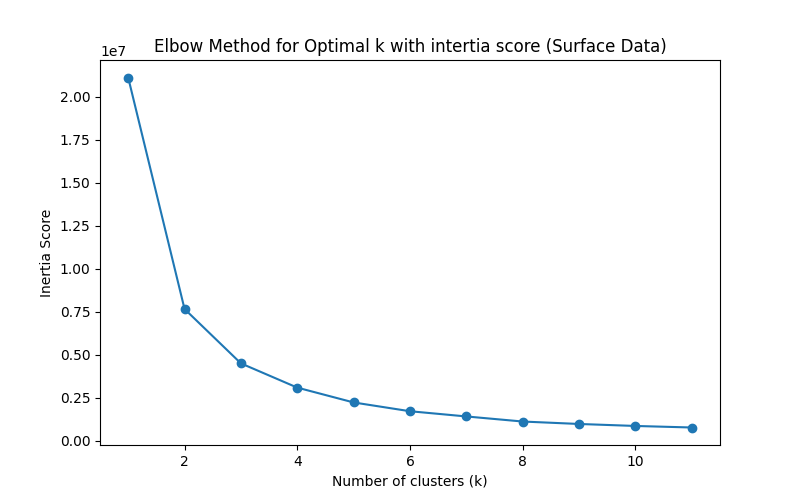

In [64]:
# Elbow method for surface data
n_clusters = range(1, 12)
inertias = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=0)
    kmeans.fit(df_surface_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']])
    inertia = kmeans.inertia_
    inertias.append(inertia)

plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score (Surface Data)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [7]:
# Do kmeans clustering on surface data with 2 clusters
kmeans_surface = KMeans(n_clusters=2, random_state=22)
X_surface = df_surface_STO.iloc[:,[0,1,2]].values
y_kmeans_surface = kmeans_surface.fit_predict(X_surface)
df_surface_STO['kmeans_classification'] = y_kmeans_surface

In [9]:
# Plot water mass classification (kmeans) in lat lon plot
import plotly.express as px

# Plot in geographic map
# Compute data centroid (mean location)
%matplotlib inline
center_lat_surf = df_surface_STO['Latitude_[deg_N]'].mean()
center_lon_surf = df_surface_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat_surf, "Center lon:", center_lon_surf)

fig = px.scatter_geo(
    df_surface_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) – Centered on Data Distribution'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat_surf, lon=center_lon_surf),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 79.19223813684268 Center lon: -86.13598615737453


In [10]:
# Do kmeans clustering on surface data with 3 clusters
kmeans_surface = KMeans(n_clusters=3, random_state=22)
X_surface = df_surface_STO.iloc[:,[0,1,2]].values
y_kmeans_surface = kmeans_surface.fit_predict(X_surface)
df_surface_STO['kmeans_classification'] = y_kmeans_surface

In [11]:
# Plot in geographic map
# Compute data centroid (mean location)
%matplotlib inline
center_lat_surf = df_surface_STO['Latitude_[deg_N]'].mean()
center_lon_surf = df_surface_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat_surf, "Center lon:", center_lon_surf)

fig = px.scatter_geo(
    df_surface_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) – Centered on Data Distribution'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat_surf, lon=center_lon_surf),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 79.19223813684268 Center lon: -86.13598615737453


# Mid-depth kmeans

In [15]:
# Take mid depth range 100m-400m
df_mid = df.copy()
df_mid = df_mid[(df_mid['Depth_[m]'] >= 100) & (df_mid['Depth_[m]'] <= 400)]
df_mid_STO = df_mid[['Latitude_[deg_N]', 'Longitude_[deg_E]','Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]
df_mid_STO = df_mid_STO.dropna()

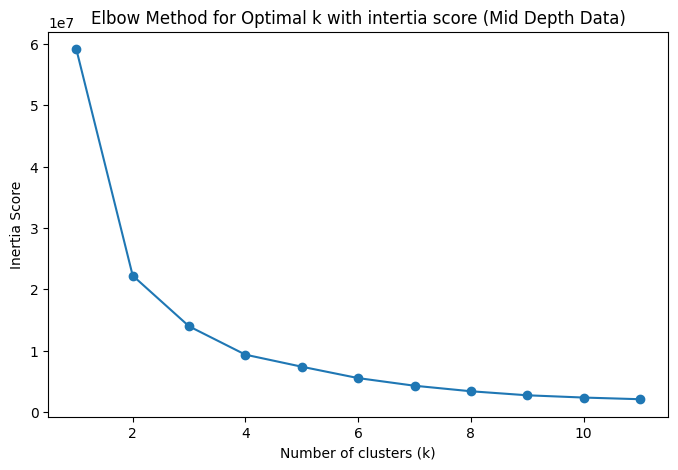

In [13]:
# Elbow method for mid depth data
n_clusters = range(1, 12)
inertias = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=0)
    kmeans.fit(df_mid_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']])
    inertia = kmeans.inertia_
    inertias.append(inertia)

# Plot elbow method
plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score (Mid Depth Data)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [14]:
# Do kmeans clustering on mid depth data with 2 clusters
kmeans_mid = KMeans(n_clusters=2, random_state=22)
X_mid = df_mid_STO.iloc[:,[0,1,2]].values
y_kmeans_mid = kmeans_mid.fit_predict(X_mid)
df_mid_STO['kmeans_classification'] = y_kmeans_mid

# Plot in geographic map
# Compute data centroid (mean location)
%matplotlib inline
center_lat = df_mid_STO['Latitude_[deg_N]'].mean()
center_lon = df_mid_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat, "Center lon:", center_lon)

fig = px.scatter_geo(
    df_mid_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) on Mid Depth Data 100m-400m'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat, lon=center_lon),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 79.98516514674644 Center lon: -92.31946944404284


# Deeper 

In [4]:
# Take deepest range 400m above
df_deep = df.copy()
df_deep = df_deep[(df_deep['Depth_[m]'] >= 400)]
df_deep_STO = df_deep[['Latitude_[deg_N]', 'Longitude_[deg_E]','Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]
df_deep_STO = df_deep_STO.dropna()

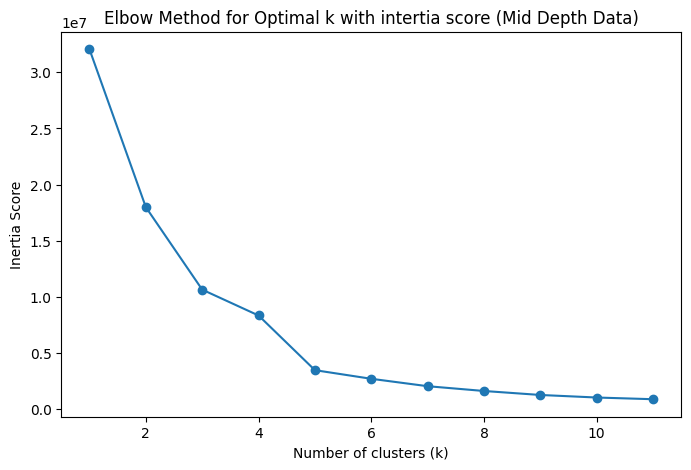

In [7]:
# Elbow method for mid depth data
n_clusters = range(1, 12)
inertias = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=22)
    kmeans.fit(df_deep_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']])
    inertia = kmeans.inertia_
    inertias.append(inertia)

# Plot elbow method
plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score (Mid Depth Data)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [12]:
# Do kmeans clustering on mid depth data with 4 clusters
kmeans_deep = KMeans(n_clusters=4, random_state=22)
X = df_deep_STO.iloc[:,[0,1,2]].values
y_kmeans = kmeans_deep.fit_predict(X)
df_deep_STO['kmeans_classification'] = y_kmeans

# Plot in geographic map
# Compute data centroid (mean location)
center_lat = df_deep_STO['Latitude_[deg_N]'].mean()
center_lon = df_deep_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat, "Center lon:", center_lon)

fig = px.scatter_geo(
    df_deep_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) on Deep Data above 400m'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat, lon=center_lon),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 80.38263192073363 Center lon: -91.50590292765631


In [13]:
# max depth
print("Max depth in data:", df['Depth_[m]'].max())  

Max depth in data: 995.0
